In [1]:
using Pkg
Pkg.add("Distributions")
Pkg.add("GR")
Pkg.add("FFTW")
Pkg.add("Plots")

using Distributions
using FFTW
using Plots

   Updating registry at `C:\Users\saman\.julia\registries\General`
   Updating git-repo `https://github.com/JuliaRegistries/General.git`


    Fetching: [===================>                     ]  

    Fetching: [=====================================

Fetching: [========================================>]  100.0 %

  Resolving package versions...
   Updating `C:\Users\saman\.julia\environments\v1.4\Project.toml`
 [no changes]
   Updating `C:\Users\saman\.julia\environments\v1.4\Manifest.toml`
 [no changes]
  Resolving package versions...
   Updating `C:\Users\saman\.julia\environments\v1.4\Project.toml`
 [no changes]
   Updating `C:\Users\saman\.julia\environments\v1.4\Manifest.toml`
 [no changes]
  Resolving package versions...
   Updating `C:\Users\saman\.julia\environments\v1.4\Project.toml`
 [no changes]
   Updating `C:\Users\saman\.julia\environments\v1.4\Manifest.toml`
 [no changes]
  Resolving package versions...
   Updating `C:\Users\saman\.julia\environments\v1.4\Project.toml`
 [no changes]
   Updating `C:\Users\saman\.julia\environments\v1.4\Manifest.toml`
 [no changes]


In [2]:
num_photons = 100
num_pixels  = 256

function fnc_1()
    num_photons = 500
    num_pixels  = 256
    A = num_photons * ones(Integer,num_pixels,num_pixels)
    x = Array(1:num_pixels)
    y = Array(1:num_pixels)
    z = A[x,y]

    heatmap(A)
end

#fnc_1()

function fnc_2()
    num_photons = 500
    num_pixels  = 256
    seed       = 42
    #rs         = np.random.RandomState(seed)
    A = num_photons * ones(Float64,num_pixels,num_pixels)
    x = Poisson(num_photons)
    for i in 1:num_pixels
        for j in 1:num_pixels
            A[i,j] = rand(x)
        end
    end
    heatmap(A)
    histogram(A; nbins = 650-350)
    #shot_noise = rs.poisson(num_photons, (num_pixels, num_pixels))

    #fig, (ax0, ax1) = plt.subplots(ncols=2)
    #img0 = ax0.imshow(mu_p, vmin=400, vmax=600)
    #ax0.set_xticks([])
    #ax0.set_yticks([])
    #ax0.set_title('No shot noise')

    #divider = make_axes_locatable(ax0)
    #cax = divider.append_axes("right", size="5%", pad=0.05)
    #cb0 = plt.colorbar(img0, cax=cax)
    #cb0.set_ticks([])

    #img1 = ax1.imshow(shot_noise, vmin=400, vmax=600)
    #ax1.set_xticks([])
    #ax1.set_yticks([])
    #ax1.set_title('Shot noise')

    #divider = make_axes_locatable(ax1)
    #cax = divider.append_axes("right", size="5%", pad=0.05)
    #cb1 = plt.colorbar(img1, cax=cax)
    #cb1.set_label('Photons')
end

function fnc_3()
    num_photons = 500
    num_pixels  = 256
    seed       = 42
    quantum_efficiency = 0.69

    dark_noise = 2.29

    #rs         = np.random.RandomState(seed)
    shot_noise = num_photons * ones(Float64,num_pixels,num_pixels)
    electrons = ones(Float64,num_pixels,num_pixels)
    dark_noise_dist = ones(Float64,num_pixels,num_pixels)
    elex_plus_darknoise = ones(Float64,num_pixels,num_pixels)

    x = Poisson(num_photons)
    norm = Normal(dark_noise)

    for i in 1:num_pixels
        for j in 1:num_pixels
            elem = rand(x)
            shot_noise[i,j] = elem
            electrons[i,j] = round((quantum_efficiency * elem), digits=3)
            #dark_noise_dist = rand(norm);
            elex_plus_darknoise[i,j] = rand(norm) + electrons[i,j]
        end
    end

    electrons

    #heatmap(shot_noise, clim=[200.,600.])
    #heatmap(electrons, clim=[200.,600.])
    heatmap(elex_plus_darknoise, clim=[200.,600.])
end

"""
dist takes the pixel position (x, y) and returns the frequency
"""
function noise(title::String, dist, pixels=256)
    A = [dist(x, y) for  x in 1:pixels, y in 1:pixels]
    h = Plots.heatmap(A, title=title, ylabel="Photons")
end

function heat(A::Array{Int64,2}, title::String)
    Plots.heatmap(A, title=title, ylabel="Photons")
end

heat (generic function with 1 method)

In [3]:
# Ground truth: a circular phase-only object
numPixels = 512
gtRadius  = 50 # ground truth radius, pixels
gtPhase   = 0.75 # radians
gtCenter  = numPixels / 2 # assumes numPixels is even

W = [convert(Float64, y) for x=0:numPixels-1, y=0:numPixels-1]
H = [convert(Float64, x) for x=0:numPixels-1, y=0:numPixels-1]

# masking
gt = ones(ComplexF64, numPixels, numPixels)
for x=1:numPixels, y=1:numPixels
    dist = sqrt((W[x, y] - gtCenter)^2 + (H[x, y] - gtCenter)^2)
    if dist <= gtRadius
        gt[x, y] = exp(1.0im * gtPhase)
    end
end



# Physical dimensions and sampling
pixelSize = 0.1 # microns

x = LinRange(-pixelSize * numPixels / 2, pixelSize * numPixels / 2, numPixels)
dx = x[2] - x[1]              # Sampling period, microns
fS = 1 / dx                      # Spatial sampling frequency, inverse microns
df = fS / numPixels              # Spacing between discrete frequency coordinates, inverse microns
fx = collect(-fS/2:df:fS/2 - df) # Spatial frequency, inverse microns

# println("x", x)
# println("dx", dx)
# println("fS", fS)
# println("df", df)
# println("fx", fx)

# Fourier transform of ground truth
GT = ifftshift(fft(fftshift(gt))) * dx^2

println("GT", size(GT))

# TODO: Wird nur in animate verwendet, wird das gebraucht?
# Angular spectrum propagator and spatial frequencies
function H_FN(fx::Array{Float64,2}, fy::Array{Float64,2}, z::Float64, wavelength::Float64=0.5)
 
    
    
     
    term = 1 .- (wavelength^2 .* fx.^2) - (wavelength^2 .* fy.^2)
    temp = zeros(Complex, size(term))
    for (i,v) in enumerate(term)
        #println(term[i])
        if term[i] < 0.0
            temp[i] = 0
        else
            temp[i] = exp(1im * 2 * pi * z / wavelength * sqrt(term[i]))
        end
    end
    
    
    
    

    #square_root = sqrt.(1 .- (wavelength^2 .* fx.^2) - (wavelength^2 .* fy.^2))
    #println("SQRT", square_root[1,1])
    #println("Exp(...) ", exp(1im * 2 * pi * z / wavelength * square_root))
    #println("TERM", 1im * 2 * pi * z / wavelength) #"np.pi: ", pi, "z: ", z, "wavelength: ", wavelength)
    #temp = exp(1im .* 2 .* pi .* z ./ wavelength .* square_root)
    #println("temp: ", temp[1,1])
    #println("sum: ", sum(temp))
    # Done(hoffentlich): temp[np.isnan(temp)] = 0 # replace nan's with zeros
    for (i, v) in enumerate(temp)
        if isnan(temp[i])
            temp[i] = 0
        end
    end
    #println("temp: ", temp[1,1])
    #println("sum: ", sum(temp))
    return temp
end

# All rows have the fx vector
# a b
# a b
FX = [x for y=1:length(fx),x in fx]

println("FX", size(FX))



# All columns have the fx vector
# a a 
# b b
FY = [x for x in fx, y=1:length(fx)]

println("FY", size(FY))

# Field at a distance of z=0
gt_prime = fftshift(ifft(ifftshift(GT))) / dx^2


# Normalizing constant: makes the maximum photon count at z = 0 equal to 100 photons
maxVal, _ = findmax([abs(x)^2 for x in gt_prime])
norm = maxVal / 100

GT(512, 512)
FX(512, 512)
FY(512, 512)


0.010000000000000014

In [4]:
function add_camera_noise(input_irrad_photons, qe=0.69, sensitivity=5.88, dark_noise=2.29, bitdepth=12, baseline=100)
    # Add shot noise
    width, height = size(input_irrad_photons)
    #print("Das sollte pos sein", minimum(input_irrad_photons))
    photons = [rand(Poisson(input_irrad_photons[x, y])) for x=1:width,y=1:height]
    
    # Convert to electrons
    electrons = qe * photons
    
    # Add dark noise
    electrons_out = [rand(Normal(dark_noise)) for x=1:width,y=1:height] .+ electrons
    
    # Convert to ADU and add baseline
    max_adu = 2^bitdepth - 1
    adu =  round.(Int, electrons_out .* sensitivity)
    adu .+= baseline
    clamp!(adu, 0, max_adu)
    
    return adu
end

add_camera_noise (generic function with 6 methods)

In [5]:
numPoints = 100
z = LinRange(0, 100, numPoints)
vmin, vmax = 0, 1500

function render_frame(frame::Integer)
    #println("GT", sum(H_FN(FX, FY, z[frame], 0.525)))
    gt_prime = fftshift(ifft(ifftshift(GT * H_FN(FX, FY, z[frame], 0.525)))) / dx^2 
    println(gt_prime[1, 1:10])
    println("sum: ", sum(gt_prime))
    # Divide by norm to convert to a photons
    hologram = abs.(gt_prime)^2 / norm
    println(sum(hologram))
    adu = add_camera_noise(hologram)
    println(adu[1, 1:10])
    println("z = $frame")
    return adu
end

anim = @animate for i ∈ 1:n
    heat(render_frame(i), "Test")
end
gif(anim, "anim_fps15.gif", fps = 15)

@gif for i=50:70 #50:numPoints
    heat(render_frame(i), "Test")
end

MethodError: MethodError: no method matching plan_bfft(::Array{Complex,2}, ::UnitRange{Int64})
Closest candidates are:
  plan_bfft(!Matched::Union{DenseArray{T,N}, Base.ReinterpretArray{T,N,S,A} where S where A<:Union{SubArray{T,N,A,I,true} where I<:Union{Tuple{Vararg{Real,N} where N}, Tuple{AbstractUnitRange,Vararg{Any,N} where N}} where A<:DenseArray where N where T, DenseArray}, Base.ReshapedArray{T,N,A,MI} where MI<:Tuple{Vararg{Base.MultiplicativeInverses.SignedMultiplicativeInverse{Int64},N} where N} where A<:Union{Base.ReinterpretArray{T,N,S,A} where S where A<:Union{SubArray{T,N,A,I,true} where I<:Union{Tuple{Vararg{Real,N} where N}, Tuple{AbstractUnitRange,Vararg{Any,N} where N}} where A<:DenseArray where N where T, DenseArray} where N where T, SubArray{T,N,A,I,true} where I<:Union{Tuple{Vararg{Real,N} where N}, Tuple{AbstractUnitRange,Vararg{Any,N} where N}} where A<:DenseArray where N where T, DenseArray}, SubArray{T,N,A,I,L} where L where I<:Tuple{Vararg{Union{Int64, AbstractRange{Int64}, Base.AbstractCartesianIndex},N} where N} where A<:Union{Base.ReinterpretArray{T,N,S,A} where S where A<:Union{SubArray{T,N,A,I,true} where I<:Union{Tuple{Vararg{Real,N} where N}, Tuple{AbstractUnitRange,Vararg{Any,N} where N}} where A<:DenseArray where N where T, DenseArray} where N where T, Base.ReshapedArray{T,N,A,MI} where MI<:Tuple{Vararg{Base.MultiplicativeInverses.SignedMultiplicativeInverse{Int64},N} where N} where A<:Union{Base.ReinterpretArray{T,N,S,A} where S where A<:Union{SubArray{T,N,A,I,true} where I<:Union{Tuple{Vararg{Real,N} where N}, Tuple{AbstractUnitRange,Vararg{Any,N} where N}} where A<:DenseArray where N where T, DenseArray} where N where T, SubArray{T,N,A,I,true} where I<:Union{Tuple{Vararg{Real,N} where N}, Tuple{AbstractUnitRange,Vararg{Any,N} where N}} where A<:DenseArray where N where T, DenseArray} where N where T, DenseArray}}, ::Any; flags, timelimit) where {T<:Union{Complex{Float32}, Complex{Float64}}, N} at C:\Users\saman\.julia\packages\FFTW\kcXL6\src\fft.jl:625
  plan_bfft(!Matched::AbstractArray{#s24,N} where N where #s24<:Real, ::Any; kws...) at C:\Users\saman\.julia\packages\AbstractFFTs\mhQvY\src\definitions.jl:199
  plan_bfft(!Matched::AbstractArray{#s15,N} where N where #s15<:(Complex{#s14} where #s14<:Union{Integer, Rational}), ::Any; kws...) at C:\Users\saman\.julia\packages\AbstractFFTs\mhQvY\src\definitions.jl:201
  ...

In [6]:
x = [i for i in 1:10]
x[:3]


3

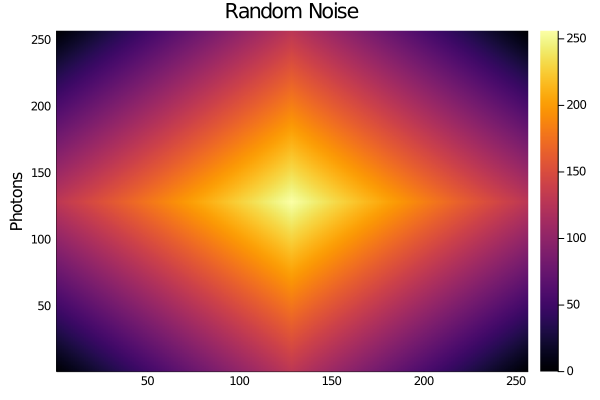

In [7]:
noise("Random Noise", (x::Integer, y::Integer) -> 256//2-abs(256//2-y) + 256//2-abs(256//2-x))

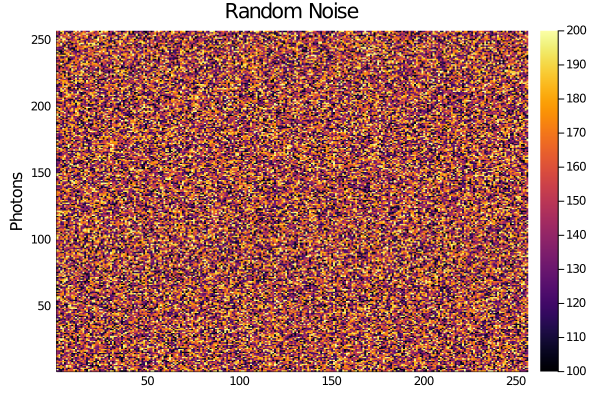

In [8]:
noise("Random Noise", (x::Integer, y::Integer) -> rand(100:200))

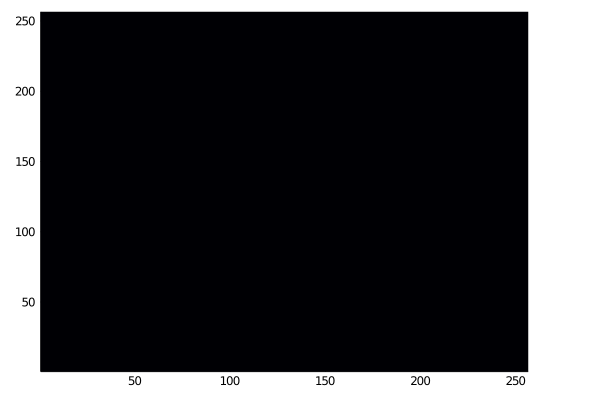

GKS: Possible loss of precision in routine SET_WINDOW
GKS: Rectangle definition is invalid in routine SET_WINDOW
GKS: Rectangle definition is invalid in routine CELLARRAY
invalid range
origin outside current window


In [9]:
fnc_1()

In [10]:
fnc_2()

In [11]:
fnc_3()

MethodError: MethodError: objects of type Array{Float64,1} are not callable
Use square brackets [] for indexing an Array.

In [12]:
 x = ones(Complex, (2,2))
x[1,1] = 3im
x

2×2 Array{Complex,2}:
 0+3im  1+0im
 1+0im  1+0im